In [3]:
import pandas as pd

## Categoría de uso de edificio (policial, salud, escolar, etc) - cantidad de pisos

In [104]:
clean = pd.read_csv('cleaned_train.csv')
clean

,building_id,damage_grade,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,...,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
0,802906,3,6,487,12198,2,30,6,5,t,...,False,False,False,False,False,False,False,False,False,False
1,28830,2,8,900,2812,2,10,8,7,o,...,False,False,False,False,False,False,False,False,False,False
2,94947,3,21,363,8973,2,10,5,5,t,...,False,False,False,False,False,False,False,False,False,False
3,590882,2,22,418,10694,2,10,6,5,t,...,False,False,False,False,False,False,False,False,False,False
4,201944,3,11,131,1488,3,30,8,9,t,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
260596,688636,2,25,1335,1621,1,55,6,3,n,...,False,False,False,False,False,False,False,False,False,False
260597,669485,3,17,715,2060,2,0,6,5,t,...,False,False,False,False,False,False,False,False,False,False
260598,602512,3,17,51,8163,3,55,6,7,t,...,False,False,False,False,False,False,False,False,False,False
260599,151409,2,26,39,1851,2,10,14,6,t,...,False,False,False,False,False,False,False,False,False,False


In [105]:
cant_pisos_por_ed = clean.loc[:,["count_floors_pre_eq", 'has_secondary_use_agriculture', 'has_secondary_use_hotel',
       'has_secondary_use_rental', 'has_secondary_use_institution',
       'has_secondary_use_school', 'has_secondary_use_industry',
       'has_secondary_use_health_post', 'has_secondary_use_gov_office',
       'has_secondary_use_use_police', 'has_secondary_use_other']]
cant_pisos_por_ed = cant_pisos_por_ed.loc[cant_pisos_por_ed["count_floors_pre_eq"]<=6]
categ_respecto_pisos = cant_pisos_por_ed.groupby("count_floors_pre_eq").sum()
categ_respecto_pisos = categ_respecto_pisos.T
# categ_respecto_pisos.reset_index()


In [106]:
# categ_respecto_pisos =categ_respecto_pisos.loc[:,['1', "2",'3', '4','5']]
for i in range (len(categ_respecto_pisos)):
    categ_respecto_pisos.iloc[i] =\
    (categ_respecto_pisos.iloc[i]/(categ_respecto_pisos.iloc[i].sum()))
# categ_respecto_pisos = categ_respecto_pisos.reset_index()
categ_respecto_pisos = categ_respecto_pisos.T

categ_respecto_pisos

,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
count_floors_pre_eq,,,,,,,,,,
1,0.111290,0.174391,0.197250,0.127049,0.223404,0.323741,0.122449,0.052632,0.130435,0.138785
2,0.666249,0.434146,0.394026,0.442623,0.361702,0.417266,0.448980,0.368421,0.391304,0.663916
3,0.219301,0.250257,0.266477,0.299180,0.244681,0.165468,0.306122,0.421053,0.391304,0.167292
4,0.002861,0.092574,0.092461,0.081967,0.095745,0.068345,0.061224,0.131579,0.086957,0.015754
5,0.000179,0.037647,0.042674,0.032787,0.042553,0.025180,0.061224,0.026316,0.000000,0.012003
6,0.000119,0.010985,0.007112,0.016393,0.031915,0.000000,0.000000,0.000000,0.000000,0.002251


In [107]:
to_plot = categ_respecto_pisos.rename(columns = {'has_secondary_use_agriculture':'Agricultura',\
                                            'has_secondary_use_hotel': 'Hotel',\
                                            'has_secondary_use_rental':'Renta',\
                                            'has_secondary_use_institution':'Institución',\
                                            'has_secondary_use_school':'Escuela',\
                                            'has_secondary_use_industry':'Industria',\
                                            'has_secondary_use_health_post':'Salud',
                                             'has_secondary_use_gov_office':'Gubernamental',\
                                            'has_secondary_use_use_police':'Policia',\
                                            'has_secondary_use_other':'Otro'})
to_plot

,Agricultura,Hotel,Renta,Institución,Escuela,Industria,Salud,Gubernamental,Policia,Otro
count_floors_pre_eq,,,,,,,,,,
1,0.111290,0.174391,0.197250,0.127049,0.223404,0.323741,0.122449,0.052632,0.130435,0.138785
2,0.666249,0.434146,0.394026,0.442623,0.361702,0.417266,0.448980,0.368421,0.391304,0.663916
3,0.219301,0.250257,0.266477,0.299180,0.244681,0.165468,0.306122,0.421053,0.391304,0.167292
4,0.002861,0.092574,0.092461,0.081967,0.095745,0.068345,0.061224,0.131579,0.086957,0.015754
5,0.000179,0.037647,0.042674,0.032787,0.042553,0.025180,0.061224,0.026316,0.000000,0.012003
6,0.000119,0.010985,0.007112,0.016393,0.031915,0.000000,0.000000,0.000000,0.000000,0.002251


Text(0.5, 1.0, 'Cantidad de Pisos Según tipo de Categoría secundaria ')

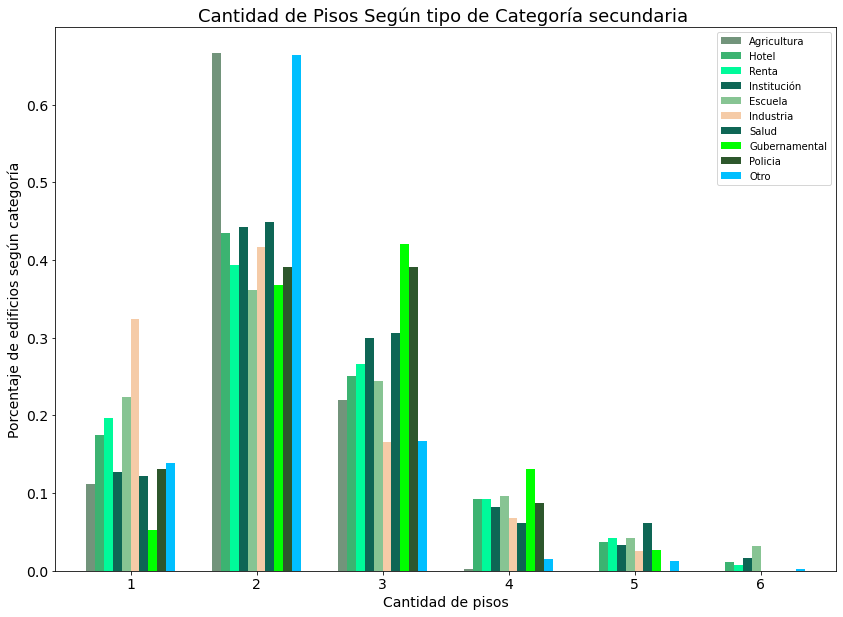

In [108]:
import numpy as np

import seaborn as sb

import matplotlib.pyplot as plt

# for i in range (len(categ_respecto_pisos)):
#     categ_respecto_pisos.iloc[i] = (categ_respecto_pisos.iloc[i]/(categ_respecto_pisos.iloc[i].sum()))
# categ_respecto_pisos = categ_respecto_pisos.reset_index()
heat_map = ax = to_plot.plot.bar(color=['#72947B',
'#3CB371',
'#00FA9A',
'#0e6655',
'#87C493', 
'#F5CBA7',
'#0E6655',
'#00FF00',                                       
'#2D572C',
'#00BFFF'],rot=0,figsize=(14,10),fontsize=14, width = 0.7)
ax.set_ylabel('Porcentaje de edificios según categoría',fontsize=14)
ax.set_xlabel('Cantidad de pisos',fontsize=14)
ax.set_title('Cantidad de Pisos Según tipo de Categoría secundaria ',fontsize=18)

Text(0.5, 1.0, 'Cantidad de Pisos Según tipo de Categoría secundaria ')

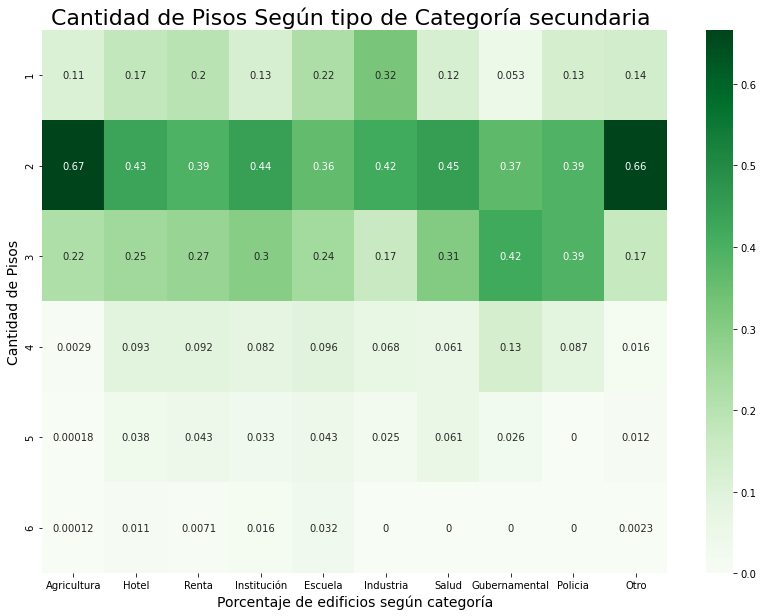

In [110]:
import seaborn as sns
fig, ax = plt.subplots(figsize=(14,10)) 
p1 = sns.heatmap(to_plot,cmap='Greens',annot=True)
#annot true por defecto pone el formato en cientifico
#ax.figure.axes[-1].set_ylabel('tipo daño', size=20)
ax.set_xlabel('Porcentaje de edificios según categoría',fontsize=14)
ax.set_ylabel('Cantidad de Pisos',fontsize=14)
# bar_kws={'label': 'Accuracy %'}"damage_grade")
ax.set_title('Cantidad de Pisos Según tipo de Categoría secundaria ',fontsize=22)


In [91]:
# libraries
import plotly.express as px


# from pandas.plotting import parallel_coordinates

ground_area = clean.loc[:,['area_percentage', 'damage_grade']]
ground_area

# Make the plot
# parallel_coordinates(ground_area, 'area_percentage',colormap=plt.get_cmap("Set2"))
# plt.show()
to_plot = categ_respecto_pisos.reset_index()
fig = px.parallel_coordinates(to_plot, color="count_floors_pre_eq",
                              dimensions=['has_secondary_use_agriculture', 'has_secondary_use_hotel',
       'has_secondary_use_rental', 'has_secondary_use_institution',
       'has_secondary_use_school', 'has_secondary_use_industry',
       'has_secondary_use_health_post', 'has_secondary_use_gov_office',
       'has_secondary_use_use_police', 'has_secondary_use_other'],
                              color_continuous_scale=px.colors.diverging.Tealrose,
                              color_continuous_midpoint=4)

fig.show()


## Top tipo construcción (escuela, centro de salud) destrozado

In [38]:
constr_type = clean.loc[:,['has_secondary_use_agriculture', 'has_secondary_use_hotel',
       'has_secondary_use_rental', 'has_secondary_use_institution',
       'has_secondary_use_school', 'has_secondary_use_industry',
       'has_secondary_use_health_post', 'has_secondary_use_gov_office',
       'has_secondary_use_use_police', 'has_secondary_use_other', 'damage_grade']]
# constr_type =constr_type.groupby('damage_grade')
constr_type = constr_type.groupby("damage_grade").sum() 
constr_type = constr_type 
for i in range (len(constr_type)):
    constr_type.iloc[i] = (constr_type.iloc[i]/(constr_type.iloc[i].sum()))
# constr_type = constr_type.reset_index()
constr_type = constr_type.rename(columns = {'has_secondary_use_agriculture':'Agricultura',\
                                            'has_secondary_use_hotel': 'Hotel',\
                                            'has_secondary_use_rental':'Renta',\
                                            'has_secondary_use_institution':'Institución',\
                                            'has_secondary_use_school':'Escuela',\
                                            'has_secondary_use_industry':'Industria',\
                                            'has_secondary_use_health_post':'Salud',
                                             'has_secondary_use_gov_office':'Gubernamental',\
                                            'has_secondary_use_use_police':'Policia',\
                                            'has_secondary_use_other':'Otro'})

Text(0.5, 1.0, 'Cantidad de daño Según tipo de Categoría secundaria ')

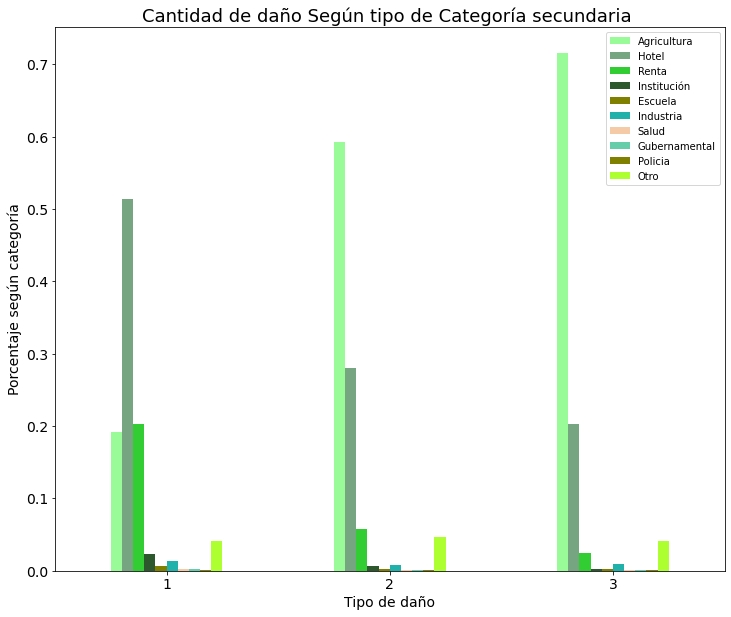

In [98]:
# bar_plot = constr_type.plot.bar(color=['lightseagreen','lightpink','teal','lime','lightgreen','lightsalmon','firebrick','grey','peru','darkorange'],\
#                                               rot=0,figsize=(10,10),fontsize=14)
ax = constr_type.plot.bar(color=['#98FB98','#76A582','#32CD32', '#2D572C',
'#808000',
'#20B2AA',
'#F5CBA7',
'#66CDAA',
'#808000',
'#ADFF2F',
],
rot=0,figsize=(12,10),fontsize=14)

ax.set_ylabel('Porcentaje según categoría',fontsize=14)
ax.set_xlabel('Tipo de daño',fontsize=14)
ax.set_title('Cantidad de daño Según tipo de Categoría secundaria ',fontsize=18)


In [64]:
constr_type = constr_type 
for i in range (len(constr_type)):
    constr_type.iloc[i] = 1000*(constr_type.iloc[i]/(constr_type.iloc[i].sum()))
constr_type = constr_type.reset_index()
    

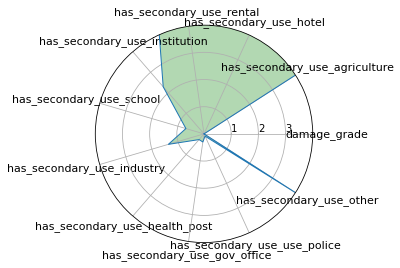

In [65]:

from math import pi
# number of variable
categories=list(constr_type)[1:]
N = len(categories)

# We are going to plot the first line of the data frame.
# But we need to repeat the first value to close the circular graph:
values=constr_type.loc[0].drop('damage_grade').values.flatten().tolist()
values += values[:1]
values
 
# What will be the angle of each axis in the plot? (we divide the plot / number of variable)
angles = [n / float(N) * 2 * pi for n in range(N)]
angles += angles[:1]
 
# Initialise the spider plot
ax = plt.subplot(111, polar=True)
 
# Draw one axe per variable + add labels
plt.xticks(angles[:-1], categories, color='black', size=11)
 
# Draw ylabels
ax.set_rlabel_position(0)
plt.yticks([10,20,30], ["1","2","3"], color="black", size=10) #radios
plt.ylim(0,40)
 
# Plot data
ax.plot(angles, values, linewidth=1, linestyle='solid')
 
# Fill area
ax.fill(angles, values, 'g', alpha=0.3)

# Show the graph
plt.show()

In [5]:
ground_area = clean.loc[:,['area_percentage','age', 'count_floors_pre_eq', 'damage_grade']]
ground_area

,area_percentage,age,count_floors_pre_eq,damage_grade
0,6,30,2,3
1,8,10,2,2
2,5,10,2,3
3,6,10,2,2
4,8,30,3,3
...,...,...,...,...
260596,6,55,1,2
260597,6,0,2,3
260598,6,55,3,3
260599,14,10,2,2


In [132]:
ground_area = clean.loc[:,['area_percentage','age', 'count_floors_pre_eq', 'damage_grade']]
ground_area = ground_area.rename(columns = { 'area_percentage':'porcentaje area','age': 'edad', \
                                            'count_floors_pre_eq': 'cantidad de pisos', 'damage_grade' :'tipo_daño'})
cols = ['porcentaje area','edad', "tipo_daño"]

fig = px.parallel_coordinates(ground_area, color="tipo_daño", dimensions=cols,
                              color_continuous_scale=px.colors.sequential.Emrld,
                              title="Relación área, edad respecto tipo de daño")
fig.show() #notar que hay muchos edificios antiguos, poner hipotesis en el informe algo que me fije recien igual me fijo con el graf que hice que justo mostraba eso

In [131]:
ground_area = clean.loc[:,['area_percentage','age', 'count_floors_pre_eq', 'damage_grade']]
ground_area = ground_area.rename(columns = { 'area_percentage':'porcentaje area','age': 'edad', \
                                            'count_floors_pre_eq': 'cantidad de pisos', 'damage_grade' :'tipo_daño'})
cols = ['cantidad de pisos','edad']

fig = px.parallel_coordinates(ground_area, color="tipo_daño", dimensions=cols,
                              color_continuous_scale=px.colors.sequential.Emrld,
                              title="Relación edad y cantidad de pisos respecto tipo de daño")
fig.show() #notar que hay muchos edificios antiguos, poner hipotesis en el informe algo que me fije recien igual me fijo con el graf que hice que justo mostraba eso

## Filtrado por edad menos a 200 anios y menos de 5 pisos

In [ ]:
filtered_ground_area = clean.loc[:,['area_percentage','age', 'count_floors_pre_eq', 'damage_grade']]\
[clean["age"] < 200]
filtered_ground_area =filtered_ground_area.loc[clean['count_floors_pre_eq']<=5].loc[clean["damage_grade"]<4]
filtered_ground_area
cols = ['area_percentage','age','count_floors_pre_eq']

fig = px.parallel_coordinates(filtered_ground_area, color="damage_grade", dimensions=cols,
                              color_continuous_scale=px.colors.sequential.Greens,
                              title="")
fig.show()

In [ ]:
orientation_damage = clean.pivot_table(index='position',columns='damage_grade',values='building_id',aggfunc='count')
for i in range (len(orientation_damage)):
    orientation_damage.iloc[i] = orientation_damage.iloc[i]/(orientation_damage.iloc[i].sum())


In [ ]:
f = clean.loc[:,["geo_level_2_id","count_fa"]].groupby("geo_level_2_id").mean()
f = f

In [ ]:
f.plot.hist()

## Cantidad de familias por geolevel